---
title: "Part1: Data Exploration and Understanding"
author: "Hrriday Ruparel"
date: "2025-02-24"
image: "./media/bb_ex2.png"
format:
    html:
        code-fold: false
        code-tools: true
jupyter: python3
---

## $\text{Importing Libraries}$

In [2]:
import os
import cv2
import numpy as np
import pandas as pd
from glob import glob
from leafmap import leafmap
from pyproj import Transformer
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from natsort.natsort import natsorted


%matplotlib inline
%config InlineBackend.figure_format = 'retina'

## $\text{Helper Functions}$

In [4]:
def display_image(im, label, ax = None):
    """
    Display an image with bounding boxes and class labels.

    Parameters:
    im (numpy.ndarray): The image to display.
    label (list): List of labels for the objects in the image. Each label is a string in the format 'class_id x_center y_center width height'.
    ax (matplotlib.axes._axes.Axes, optional): The axes on which to display the image. If None, a new figure is created.

    Returns:
    matplotlib.axes._axes.Axes: The axes with the image and bounding boxes.
    """
    class_colors = {0: (0, 255, 0), 1: (255, 0, 0), 2: (0, 0, 255)}
    class_labels = {0: 'Class 0', 1: 'Class 1', 2: 'Class 2'}
    class_colors_for_legend = {0: (0, 255, 0), 1: (0, 0, 255), 2: (255, 0, 0)}
    
    if ax is None:
        for line in label:
            line = line.strip().split()
            class_id, x_center, y_center, width, height = map(float, line)
            x_center, y_center = int(x_center * im.shape[1]), int(y_center * im.shape[0])
            width, height = int(width * im.shape[1]), int(height * im.shape[0])
            
            x1, y1 = x_center - width // 2, y_center - height // 2
            x2, y2 = x_center + width // 2, y_center + height // 2
            color = class_colors[int(class_id)]
            cv2.rectangle(im, (x1, y1), (x2, y2), color, 2)
            
        plt.figure(figsize=(6, 6))
        plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        
        # Create custom legend handles
        handles = [mpatches.Patch(color=np.array(color)/255, label=class_labels[class_id]) for class_id, color in class_colors_for_legend.items()]
        plt.legend(handles=handles, loc='upper right')
        plt.show()
        return
    else:
        for line in label:
            line = line.strip().split()
            class_id, x_center, y_center, width, height = map(float, line)
            x_center, y_center = int(x_center * im.shape[1]), int(y_center * im.shape[0])
            width, height = int(width * im.shape[1]), int(height * im.shape[0])
            
            x1, y1 = x_center - width // 2, y_center - height // 2
            x2, y2 = x_center + width // 2, y_center + height // 2
            color = class_colors[int(class_id)]
            cv2.rectangle(im, (x1, y1), (x2, y2), color, 2)
        
        ax.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
        ax.axis('off')
        
        # Create custom legend handles
        handles = [mpatches.Patch(color=np.array(color)/255, label=class_labels[class_id]) for class_id, color in class_colors_for_legend.items()]
        ax.legend(handles=handles, loc='upper right')
    return ax


def extract_bounds(file_name):
    min_x = file_name.split("_")[5]
    min_y = file_name.split("_")[7]
    min_x, min_y = map(float, [min_x, min_y])
    return [[min_x, min_y], [min_x+416, min_y], [min_x+416, min_y+416], [min_x, min_y+416]]

def get_lat_long_of_chip(file_name):
    """
    Get the latitude and longitude of the corners of an image chip.

    Parameters:
    file_name (str): The name of the file containing the image chip.

    Returns:
    list: A list of latitude and longitude coordinates for the corners of the image chip.
    """
    tiles = [  (307670.04, 0.31, 0.0, 5434427.100000001, 0.0, -0.31),
                (312749.07999999996, 0.31, 0.0, 5403952.860000001, 0.0, -0.31),
                (312749.07999999996, 0.31, 0.0, 5363320.540000001, 0.0, -0.31)]

    tile_index = int(file_name.split("_")[2])-1
    bounds = extract_bounds(file_name)
    lat_long = []
    for bound in bounds:
        x, y = bound
        e = tiles[tile_index][0] + ((x) * tiles[tile_index][1])
        n = tiles[tile_index][3] + ((y) * tiles[tile_index][-1])
        transformer = Transformer.from_crs("epsg:32633", "epsg:4326", always_xy=True)

        long, lat = transformer.transform(e,n)
        lat_long.append([lat, long])
    return lat_long

def get_lat_long_of_bb(file_name, label, instance_idx):
    """
    Get the latitude and longitude of the bounding box corners for a specific instance in an image chip.

    Parameters:
    file_name (str): The name of the file containing the image chip.
    label (list): List of labels for the objects in the image. Each label is a string in the format 'class_id x_center y_center width height'.
    instance_idx (int): The index of the instance in the label list for which to get the bounding box coordinates.

    Returns:
    list: A list of latitude and longitude coordinates for the corners of the bounding box.
    """
    tiles = [  (307670.04, 0.31, 0.0, 5434427.100000001, 0.0, -0.31),
                (312749.07999999996, 0.31, 0.0, 5403952.860000001, 0.0, -0.31),
                (312749.07999999996, 0.31, 0.0, 5363320.540000001, 0.0, -0.31)]

    tile_index = int(file_name.split("_")[2])-1
    data = label[instance_idx].strip().split()
    x_center, y_center, width, height = map(float, data[1:])
    x_center, y_center = x_center * 416, y_center * 416
    width, height = width * 416, height * 416

    min_x, min_y = extract_bounds(file_name)[0]

    coords = [((x_center + min_x), (y_center + min_y)), 
              ((x_center + min_x) - width / 2, (y_center + min_y) - height / 2), 
              ((x_center + min_x) + width / 2, (y_center + min_y) - height / 2), 
              ((x_center + min_x) + width / 2, (y_center + min_y) + height / 2), 
              ((x_center + min_x) - width / 2, (y_center + min_y) + height / 2)]
    
    lat_long = []
    for coord in coords:
        x, y = coord
        e = tiles[tile_index][0] + ((x) * tiles[tile_index][1])
        n = tiles[tile_index][3] + ((y) * tiles[tile_index][-1])
        transformer = Transformer.from_crs("epsg:32633", "epsg:4326", always_xy=True)
        long, lat = transformer.transform(e,n)
        lat_long.append([lat, long])
    return lat_long

## $\text{Loading Data}$

In [5]:
labels_dir_path = "./labels/labels_native/"
label_files = glob(labels_dir_path + "*.txt")
label_files = [label_file.split("/")[-1] for label_file in label_files]
label_files = natsorted(label_files)

images_dir_path = "./maxar/image_chips/image_chips_native/"
image_files = glob(images_dir_path + "*.tif")
image_files = [image_file.split("/")[-1] for image_file in image_files]
image_files = natsorted(image_files)

print("Number of files: \nLabels: {}\nImages: {}".format(len(label_files), len(image_files)))

Number of files: 
Labels: 2542
Images: 2542


In [6]:
all_labels = []
for label_file_path in label_files:
    with open(os.path.join(labels_dir_path, label_file_path), 'r') as f:
        all_labels.append(f.readlines())
f.close()
len(all_labels)

2542

In [7]:
all_images = []
for image_file_path in image_files:
    all_images.append(cv2.imread(os.path.join(images_dir_path, image_file_path)))
all_images = np.array(all_images)

In [8]:
all_images.shape

(2542, 416, 416, 3)

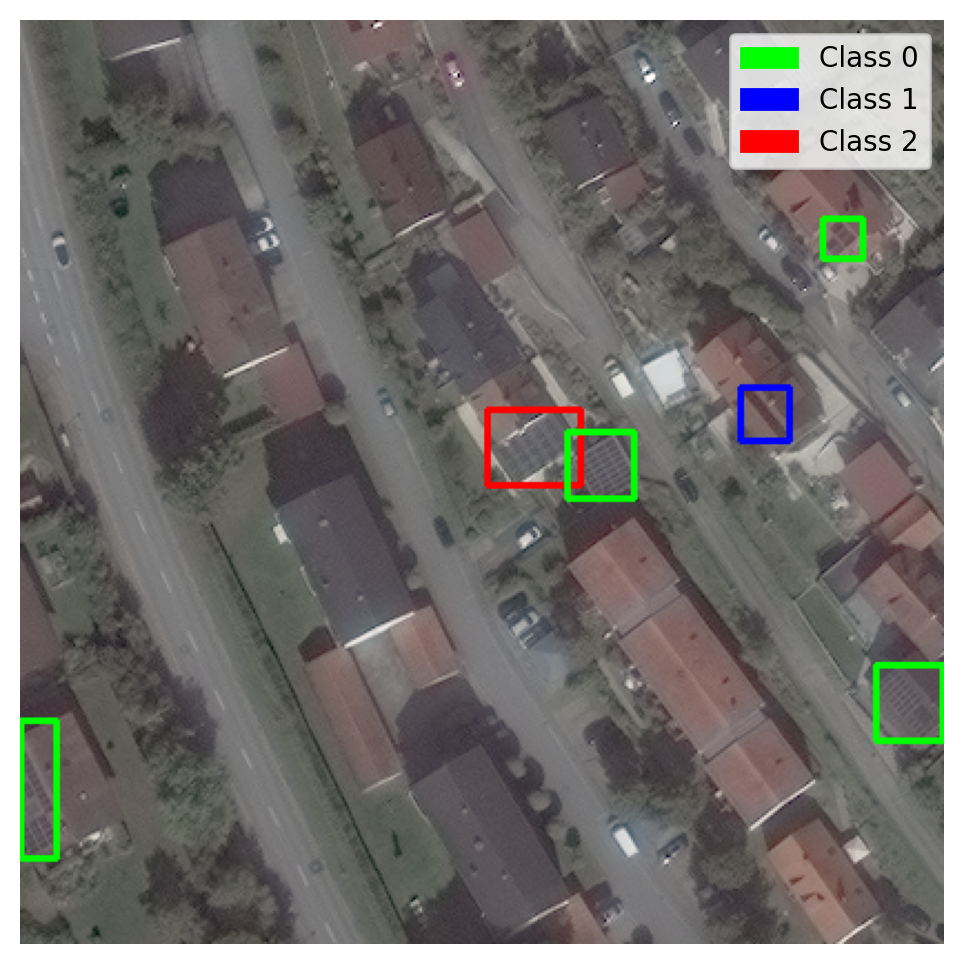

In [9]:
idx = 761
display_image(all_images[idx], all_labels[idx])

## $\text{Data Exploration and Understanding}$

### $\text{Dataset Statistics}$
- How many instances of solar panels are present in the dataset?
- Compute and show the value counts of labels per image. E.g., X images have 0 labels, Y images have 1 label, … and so on.


| Class ID | Description                   | Count |
|----------|-------------------------------|-------|
| 0        | High Confidence Detection     | 29267 |
| 1        | Moderate Confidence Detection | 130   |
| 2        | Low Confidence Detection      | 228   |
|          | **Total**                     | 29635 |

In [10]:
# How many instances of solar panels are present in the dataset?

total_instances = 0 # Here, 'instance' means a single solar panel detection 
for label in all_labels:
    total_instances += len(label)
print("Total number of images: {}".format(len(all_labels)))
print("Total instances of solar panels: {}".format(total_instances))

Total number of images: 2542
Total instances of solar panels: 29625


In [11]:
# Compute and show the value counts of labels per image. E.g., X images have 0 labels, Y images have 1 label, … and so on.

label_counts = [len(label) for label in all_labels]
label_counts = pd.Series(label_counts)
label_counts = pd.DataFrame(label_counts.value_counts(), columns=['count'])
label_counts.reset_index(inplace=True)
label_counts.columns = ['Number of instances per image', 'Number of images']
label_counts

,Number of instances per image,Number of images
0,3,221
1,4,218
2,5,217
3,6,189
4,8,184
...,...,...
69,64,1
70,61,1
71,56,1
72,55,1


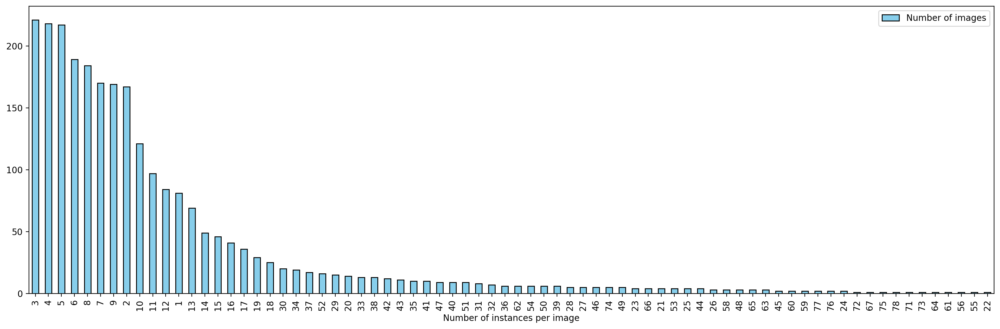

In [12]:
label_counts.plot(x='Number of instances per image', y='Number of images', kind='bar', figsize=(20, 6), color='skyblue', edgecolor='black')
plt.show()

In [13]:
# Number of instances per class

class_counts = {0: 0, 1: 0, 2: 0}
for label in all_labels:
    for line in label:
        class_id = int(line.strip().split()[0])
        class_counts[class_id] += 1
class_counts

{0: 29267, 1: 130, 2: 228}

### $\text{Calculate the statistics of the area of solar panels in meters}$
- What method was used to compute the area (in meters) for a single instance?
- What is the mean area and standard deviation?
- Plot the histogram of areas. What do you observe?


In [19]:
# What method was used to compute the area (in meters) for a single instance?

print("""
The area of a single instance is computed by multiplying the width and height of the bounding box by the area of a single pixel in squared meters.

Area of a single pixel:                 0.31 m x 0.31 m = 0.0961 m^2/pixel                                      [0.31 meters is the resolution of the image]
Area of a single instance (approx):     (x_width x 416) x (y_width x 416) x 0.0961 m^2/pixel                    [416 is the size of the image]
""")


The area of a single instance is computed by multiplying the width and height of the bounding box by the area of a single pixel in squared meters.

Area of a single pixel:                 0.31 m x 0.31 m = 0.0961 m^2/pixel                                      [0.31 meters is the resolution of the image]
Area of a single instance (approx):     (x_width x 416) x (y_width x 416) x 0.0961 m^2/pixel                    [416 is the size of the image]



In [20]:
# What is the mean area and standard deviation?

areas = []
for label in all_labels:
    for line in label:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())
        areas.append(width * height * 0.0961 * 416**2)
print("Mean area: {:.2f} m^2".format(np.mean(areas)))
print("Standard deviation: {:.2f} m^2".format(np.std(areas)))

Mean area: 191.52 m^2
Standard deviation: 630.70 m^2


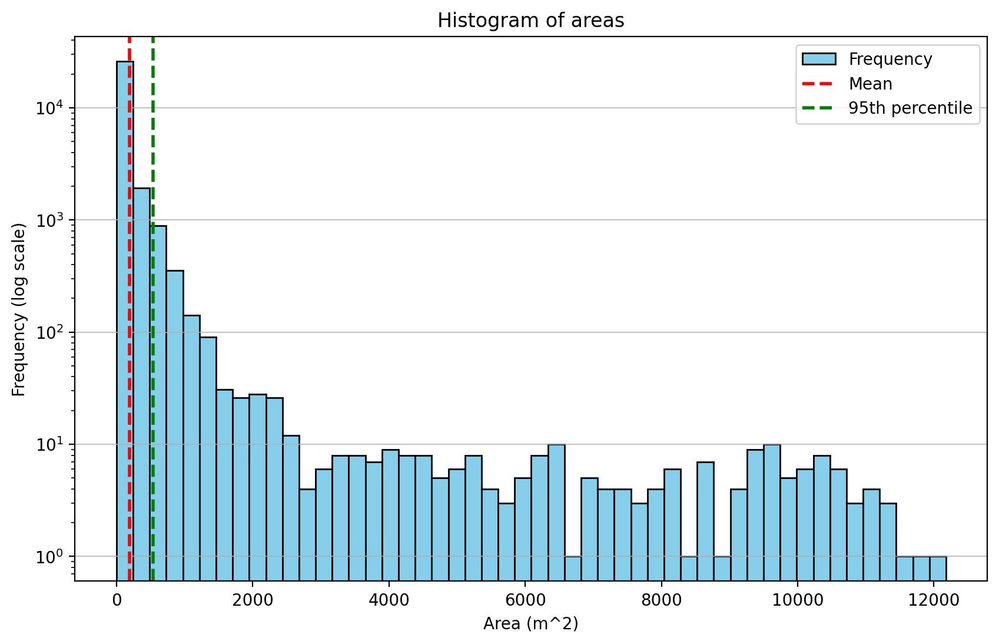

More than 95% of instances have an area less than 540.18 m^2. There are very few instances with extremely large areas (as large as 12177.41 m^2)


In [21]:
# Plot the histogram of areas. What do you observe?

plt.figure(figsize=(10, 6))
plt.hist(areas, bins=50, color='skyblue', edgecolor='black', label='Frequency')
plt.axvline(x=np.mean(areas), color='red', linestyle='dashed', linewidth=2, label = 'Mean')
plt.axvline(x=np.percentile(areas, 95), color='green', linestyle='dashed', linewidth=2, label = '95th percentile')
plt.xlabel('Area (m^2)')
plt.ylabel('Frequency (log scale)')
plt.title('Histogram of areas')
plt.grid(axis='y', alpha=0.75)
plt.yscale('log')
plt.legend()
plt.show()

print(f"More than 95% of instances have an area less than {np.percentile(areas, 95):.2f} m^2. There are very few instances with extremely large areas (as large as {max(areas):.2f} m^2)")

### $\text{Georeferencing}$

- Find each bounding box's center coordinate (longitude, latitude) (Hint: use the information provided in the README file). Explain your method and show the verification with Google Maps Satellite view that your identification is correct.
- Visualize the geolocations using the leafmap library with SATELLITE basemap. [https://leafmap.org/] Where are the clusters located?


In [22]:
# Find each bounding box's center coordinate (longitude, latitude) (Hint: use the information provided in the README file). 
# Explain your method and show the verification with Google Maps Satellite view that your identification is correct.

print("""
Method:
1. Extract the tile index and min x & y bounds (x0 & y0) from the label_file's name.
2. Compute the EPSG:32633 coordinates of the desired chip using min x & y bounds and the tile index from the tile information given in the README file.
      E = E0 + (x0 * x_res)         [x_rot = 0, E0 -> Easting of tile's upper-left corner]
      N = N0 + (y0 * y_res)         [y_rot = 0, N0 -> Northing of tile's upper-left corner]
3. Extract and compute the x_width, y_width, x_center, and y_center of the bounding box (in pixels) from the corresponding instance in all_labels.
      x_width = width * 416         [416 is the size of the image]
      y_width = height * 416        [416 is the size of the image]
      x_center = x_center * 416     [416 is the size of the image]
      y_center = y_center * 416     [416 is the size of the image]
4. Compute the coordinates of the bounding box using the chip's EPSG:32633 coordinates.
      x = E + (x_center * x_res)
      y = N + (y_center * y_res)
5. Convert the computed coordinates from EPSG:32633 to latitude and longitude using a coordinate transformer (EPSG:32633 -> EPSG:4326).
6. Return the computed latitude and longitude coordinates of the bounding box. 
""")


Method:
1. Extract the tile index and min x & y bounds (x0 & y0) from the label_file's name.
2. Compute the EPSG:32633 coordinates of the desired chip using min x & y bounds and the tile index from the tile information given in the README file.
      E = E0 + (x0 * x_res)         [x_rot = 0, E0 -> Easting of tile's upper-left corner]
      N = N0 + (y0 * y_res)         [y_rot = 0, N0 -> Northing of tile's upper-left corner]
3. Extract and compute the x_width, y_width, x_center, and y_center of the bounding box (in pixels) from the corresponding instance in all_labels.
      x_width = width * 416         [416 is the size of the image]
      y_width = height * 416        [416 is the size of the image]
      x_center = x_center * 416     [416 is the size of the image]
      y_center = y_center * 416     [416 is the size of the image]
4. Compute the coordinates of the bounding box using the chip's EPSG:32633 coordinates.
      x = E + (x_center * x_res)
      y = N + (y_center * y_res)
5.

**IMPORTANT**: <br>
**Due to an unidentified cause, an inconsistent offset is being observed in the following questions.**<br>
**As a result, the bounding boxes estimated by the (lat, long) are not visually appearing to enclose the solar panel instance.**

#### Obtaining the coordinates of the desired chip

##### Example 1

In [23]:
label_files[0]

'solarpanels_native_1__x0_0_y0_6845_dxdy_416.txt'

In [24]:
get_lat_long_of_chip(file_name=label_files[0])

[[49.013634580074424, 12.369630665081079],
 [49.0136747546675, 12.371392421009944],
 [49.0125159047291, 12.371453474625222],
 [49.012475731766365, 12.369691759500945]]

![new](./media/new_chip_ex1.png) <br><br>
Obtained from Google Earth

In [25]:
new = cv2.imread('./media/new_chip_ex1.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)
old = cv2.imread(os.path.join(images_dir_path, image_files[0]))
old = cv2.cvtColor(old, cv2.COLOR_BGR2RGB)

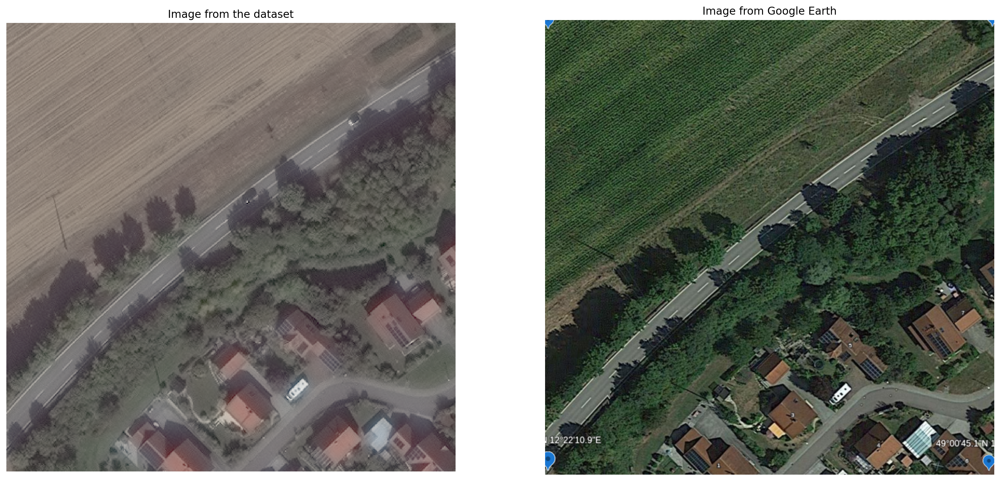

In [26]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
ax[0].imshow(old)
ax[0].set_title('Image from the dataset')
ax[0].axis('off')
plt.show()

##### Example 2

In [27]:
label_files[1000]

'solarpanels_native_2__x0_0_y0_11476_dxdy_416.txt'

In [28]:
get_lat_long_of_chip(file_name=label_files[1000])

[[48.72842676305991, 12.453623859284367],
 [48.728465488528265, 12.455375746240692],
 [48.72730650416857, 12.455434260621793],
 [48.72726778026977, 12.453682413844513]]

![new](./media/new_chip_ex2.png) <br><br>
Obtained from Google Earth

In [29]:
new = cv2.imread('./media/new_chip_ex2.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)
old = cv2.imread(os.path.join(images_dir_path, image_files[1000]))
old = cv2.cvtColor(old, cv2.COLOR_BGR2RGB)

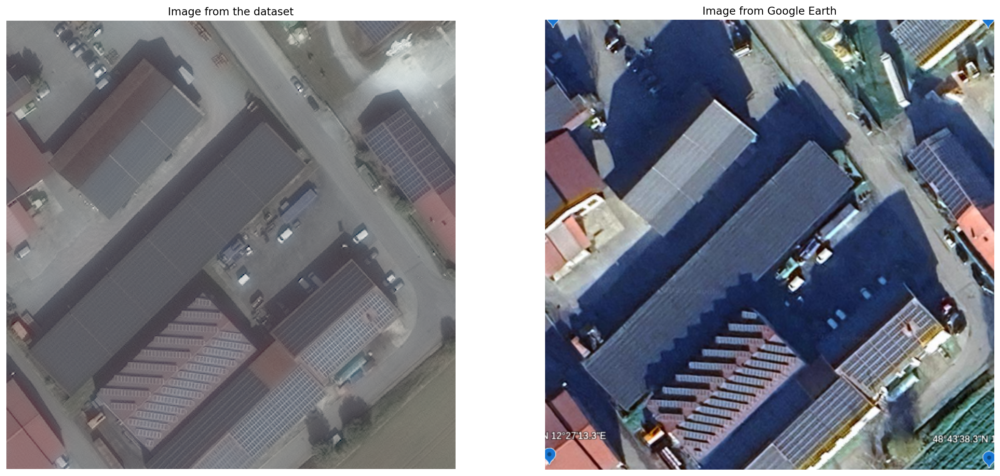

In [30]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
ax[0].imshow(old)
ax[0].set_title('Image from the dataset')
ax[0].axis('off')
plt.show()

##### Example 3

In [31]:
label_files[2000]

'solarpanels_native_3__x0_7403_y0_13361_dxdy_416.txt'

In [32]:
get_lat_long_of_chip(file_name=label_files[2000])

[[48.35866815685048, 12.503100376777843],
 [48.35870591676594, 12.504839615313871],
 [48.35754681354012, 12.504896252762075],
 [48.35750905515276, 12.503157053604903]]

![new](./media/new_chip_ex3.png) <br><br>
Obtained from Google Earth

In [33]:
new = cv2.imread('./media/new_chip_ex3.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)
old = cv2.imread(os.path.join(images_dir_path, image_files[2000]))
old = cv2.cvtColor(old, cv2.COLOR_BGR2RGB)

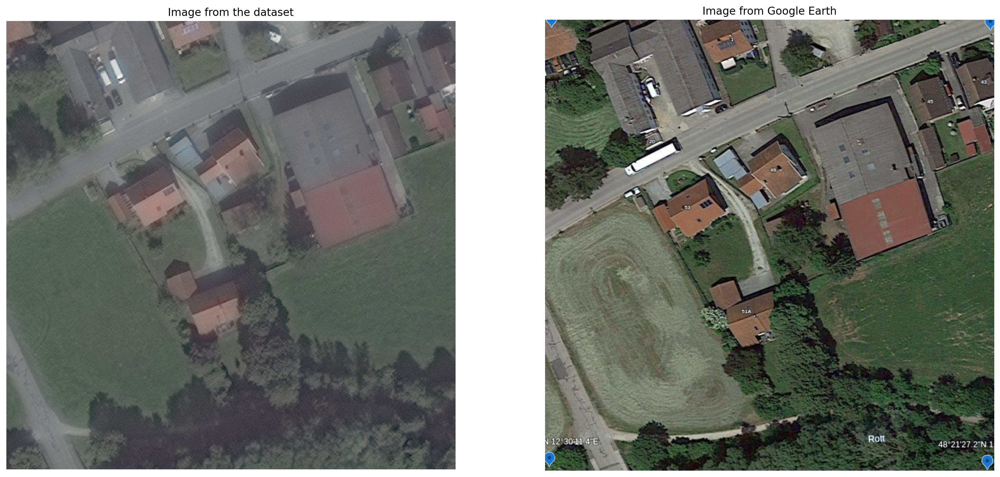

In [34]:
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
ax[0].imshow(old)
ax[0].set_title('Image from the dataset')
ax[0].axis('off')
plt.show()

#### Obtaining the coordinates of the desired bounding box

##### Example 1

In [35]:
label_files[0], all_labels[0]

('solarpanels_native_1__x0_0_y0_6845_dxdy_416.txt',
 ['0 0.8725961538461539 0.7007211538461539 0.057692307692307696 0.05528846153846154\n',
  '0 0.6201923076923077 0.6826923076923077 0.04326923076923077 0.038461538461538464\n',
  '0 0.7235576923076924 0.7548076923076924 0.05288461538461539 0.05288461538461539\n',
  '0 0.875 0.9350961538461539 0.028846153846153848 0.028846153846153848\n',
  '0 0.9158653846153847 0.9591346153846154 0.04326923076923077 0.03365384615384616\n',
  '0 0.9627403846153847 0.9963942307692308 0.040865384615384616 0.007211538461538462\n',
  '0 0.3245192307692308 0.9663461538461539 0.057692307692307696 0.0625\n',
  '0 0.6586538461538461 0.7223557692307693 0.038461538461538464 0.03125\n'])

In [36]:
get_lat_long_of_chip(file_name=label_files[0])

[[49.013634580074424, 12.369630665081079],
 [49.0136747546675, 12.371392421009944],
 [49.0125159047291, 12.371453474625222],
 [49.012475731766365, 12.369691759500945]]

In [37]:
get_lat_long_of_bb(file_name=label_files[0], label=all_labels[0], instance_idx=1)

[[49.01286836172854, 12.370764983932983],
 [49.01288977821848, 12.370725695204499],
 [49.012891516355644, 12.370801923877265],
 [49.012846945224595, 12.370804272627897],
 [49.01284520709013, 12.370728044023037]]

![new](./media/bb_ex1.png) <br><br>
Obtained from Google Earth

In [38]:
new = cv2.imread('./media/bb_ex1.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)

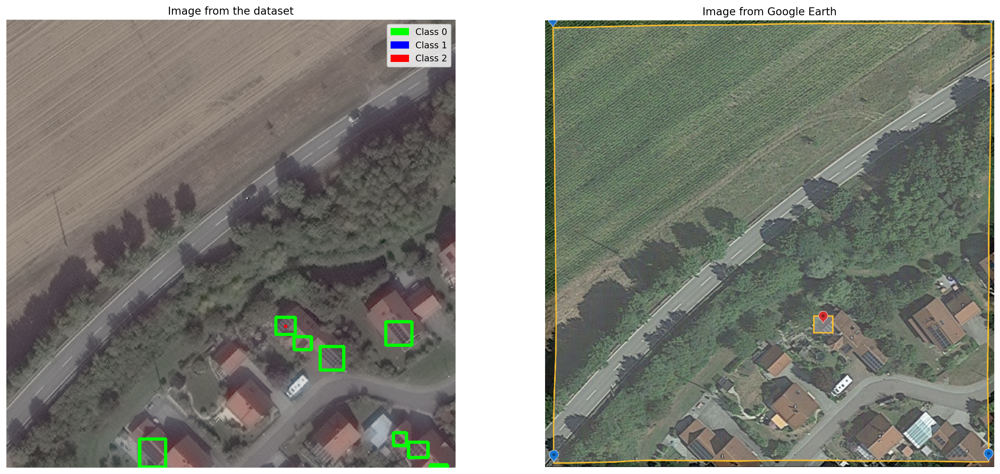

In [39]:
x_center, y_center, width, height = map(float, all_labels[0][1].strip().split(" ")[1:])
x_center, y_center = x_center * 416, y_center*416
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
display_image(all_images[0], all_labels[0], ax=ax[0])
ax[0].set_title('Image from the dataset')
ax[0].scatter(x_center, y_center, c='red', s=10, marker='x', label='Center of the bounding box')
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
plt.show()

##### Example 2

In [40]:
label_files[1000], all_labels[1000]

('solarpanels_native_2__x0_0_y0_11476_dxdy_416.txt',
 ['0 0.3665865384615385 0.22235576923076925 0.1466346153846154 0.14182692307692307\n',
  '0 0.29927884615384615 0.296875 0.14182692307692307 0.14182692307692307\n',
  '0 0.875 0.028846153846153848 0.25 0.057692307692307696\n',
  '0 0.9182692307692308 0.29086538461538464 0.16346153846153846 0.19230769230769232\n',
  '0 0.8713942307692308 0.31490384615384615 0.1514423076923077 0.17307692307692307\n',
  '0 0.23076923076923078 0.3737980769230769 0.13461538461538464 0.14182692307692307\n',
  '0 0.3545673076923077 0.530048076923077 0.6225961538461539 0.6129807692307693\n',
  '0 0.7055288461538461 0.6430288461538461 0.23317307692307693 0.21875\n',
  '0 0.764423076923077 0.6983173076923077 0.21634615384615385 0.19951923076923078\n',
  '0 0.6033653846153847 0.8798076923076924 0.22115384615384617 0.22115384615384617\n',
  '0 0.46274038461538464 0.9603365384615385 0.19951923076923078 0.07932692307692309\n',
  '0 0.44591346153846156 0.8870192307

In [41]:
get_lat_long_of_chip(file_name=label_files[1000])

[[48.72842676305991, 12.453623859284367],
 [48.728465488528265, 12.455375746240692],
 [48.72730650416857, 12.455434260621793],
 [48.72726778026977, 12.453682413844513]]

In [42]:
get_lat_long_of_bb(file_name=label_files[1000], label=all_labels[1000], instance_idx=6)

[[48.72782618003159, 12.454276050344484],
 [48.72816933972369, 12.453712752265622],
 [48.72819345224244, 12.454803464416429],
 [48.72748301743422, 12.454839340767492],
 [48.72745890551453, 12.453748643950552]]

![new](./media/bb_ex2.png) <br><br>
Obtained from Google Earth

In [43]:
new = cv2.imread('./media/bb_ex2.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)

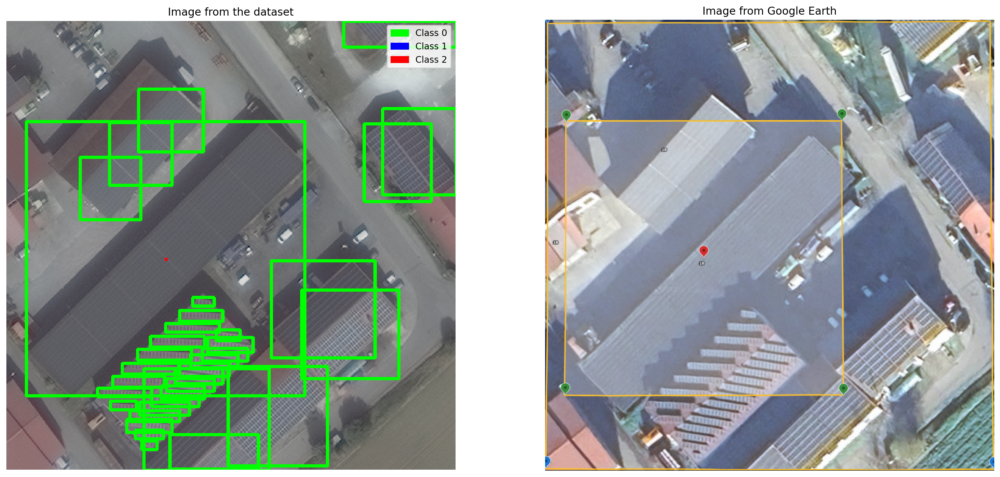

In [44]:
x_center, y_center, width, height = map(float, all_labels[1000][6].strip().split(" ")[1:])
x_center, y_center = x_center * 416, y_center*416
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
display_image(all_images[1000], all_labels[1000], ax=ax[0])
ax[0].set_title('Image from the dataset')
ax[0].scatter(x_center, y_center, c='red', s=10, marker='x', label='Center of the bounding box')
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
plt.show()

##### Example 3

In [45]:
label_files[2000], all_labels[2000]

('solarpanels_native_3__x0_7403_y0_13361_dxdy_416.txt',
 ['0 0.40625 0.018028846153846156 0.04326923076923077 0.03605769230769231\n',
  '0 0.359375 0.3774038461538462 0.026442307692307696 0.02403846153846154\n'])

In [46]:
get_lat_long_of_chip(file_name=label_files[2000])

[[48.35866815685048, 12.503100376777843],
 [48.35870591676594, 12.504839615313871],
 [48.35754681354012, 12.504896252762075],
 [48.35750905515276, 12.503157053604903]]

In [47]:
get_lat_long_of_bb(file_name=label_files[2000], label=all_labels[2000], instance_idx=1)

[[48.358244280231766, 12.503746800346855],
 [48.358257712475286, 12.5037231247565],
 [48.35825871101753, 12.503769113843202],
 [48.3582308479831, 12.503770475924807],
 [48.35822984944184, 12.503724486863135]]

![new](./media/bb_ex3.png) <br><br>
Obtained from Google Earth

In [48]:
new = cv2.imread('./media/bb_ex3.png')
new = cv2.cvtColor(new, cv2.COLOR_BGR2RGB)

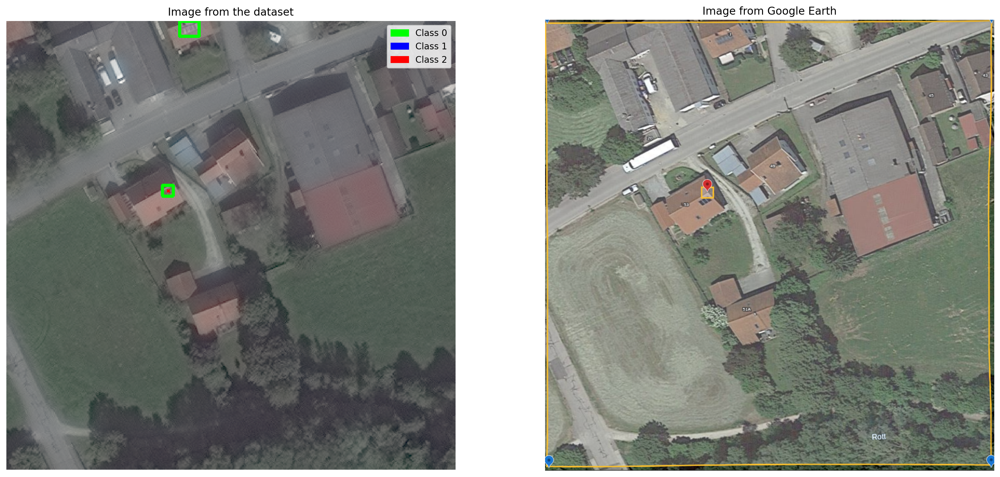

In [49]:
x_center, y_center, width, height = map(float, all_labels[2000][1].strip().split(" ")[1:])
x_center, y_center = x_center * 416, y_center*416
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
display_image(all_images[2000], all_labels[2000], ax=ax[0])
ax[0].set_title('Image from the dataset')
ax[0].scatter(x_center, y_center, c='red', s=10, marker='x', label='Center of the bounding box')
ax[1].imshow(new)
ax[1].set_title('Image from Google Earth')
ax[1].axis('off')
plt.show()

#### Leafmap Georeferencing

In [50]:
m = leafmap.Map()
m.add_basemap('Google Hybrid', visible = True)
m.add_markers(markers = get_lat_long_of_bb(file_name=label_files[0], label=all_labels[0], instance_idx=1), x='lon', y='lat', radius=10, popup=None, font_size=2, stroke=True, color='#0033FF', weight=2, fill=True, fill_color=None, fill_opacity=0.2, opacity=1.0, shape='circle')
m.add_markers(markers = get_lat_long_of_bb(file_name=label_files[1000], label=all_labels[1000], instance_idx=6), x='lon', y='lat', radius=10, popup=None, font_size=2, stroke=True, color='#0033FF', weight=2, fill=True, fill_color=None, fill_opacity=0.2, opacity=1.0, shape='circle')
m.add_markers(markers = get_lat_long_of_bb(file_name=label_files[2000], label=all_labels[2000], instance_idx=1), x='lon', y='lat', radius=10, popup=None, font_size=2, stroke=True, color='#0033FF', weight=2, fill=True, fill_color=None, fill_opacity=0.2, opacity=1.0, shape='circle')
m

Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

As one can observe, the clusters are located near Munich, Germany. 